In [1]:
from thinkdsp import *
from scipy.stats import linregress
import thinkplot
import numpy as np
import matplotlib.pyplot as plt

sig = UncorrelatedGaussianNoise()
wave = sig.make_wave(duration = 1, framerate = 2**14)
def plot_res(tm, ns, clr='cyan'):
    thinkplot.plot(ns, tm, color=clr)
    
    x = np.log(ns)
    y = np.log(tm)
    t = linregress(x,y)
    slope = t[0]
    
    return slope
def analyze1(ys, fs, ts):
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.linalg.solve(M, ys)
    return amps
def analyze2(ys, fs, ts):
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.dot(M, ys) / 2
    return amps

1.2 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
1.81 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
4.11 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
14.8 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
15.3 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
15 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
31.3 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
18.7 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
64.9 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
140 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
346 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
487 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
1.42 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
1.37 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
first  1.6250188690455885
second  1.4996114407960521


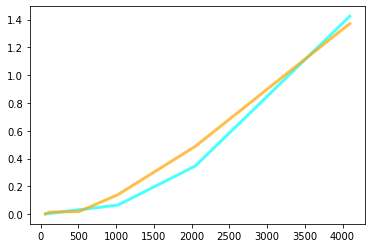

In [2]:
res1 = []
res2 = []
ns = 2 ** np.arange(6, 13)
for n in ns:
    ts = (0.5 + np.arange(n)) / n
    fq = (0.5 + np.arange(n)) / 2
    ys = wave.ys[:n]
    r1 = %timeit -r1 -o analyze1(ys, fq, ts)
    r2 = %timeit -r1 -o analyze1(ys, fq, ts)
    res1.append(r1)
    res2.append(r2)

t1 = [r.best for r in res1]
t2 = [r.best for r in res2]
print("first ", plot_res(t1, ns))
print("second ", plot_res(t2, ns, clr='orange'))

In [11]:
def compress(dct, thresh=1):
    count = 0
    for i, amp in enumerate(dct.amps):
        if np.abs(amp) < thresh:
            dct.hs[i] = 0
            count += 1
            
    n = len(dct.amps)
    return (count, n)

In [12]:
def make_dct_spectrogram(wave, seg_length):
    window = np.hamming(seg_length)
    i, j = 0, seg_length
    step = seg_length // 2
    spec_map = {}
    while j < len(wave.ys):
        segment = wave.slice(i, j)
        segment.window(window)
        t = (segment.start + segment.end) / 2
        spec_map[t] = segment.make_dct()
        i += step
        j += step
    return Spectrogram(spec_map, seg_length)

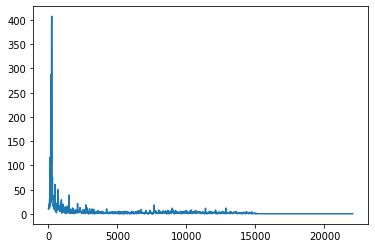

In [13]:
wave = read_wave('sound/halzion.wav')
segment = wave.segment(start=20, duration=0.1)
segment.make_spectrum().plot()
wave.make_audio()

In [19]:
spectrogram = make_dct_spectrogram(wave, seg_length=512)
total = 0;
rem = 0;
for t, dct in spectrogram.spec_map.items():
    cnt, n = compress(dct, thresh=1)
    total += n;
    rem += cnt;
print("removed", rem, "of", total, "percent", rem / total)

removed 11777322 of 17519616 percent 0.6722363092889707


In [20]:
spectrogram.make_wave().make_audio()